# UFRJ Analytica - Processo Seletivo 2022

Por Marcos Eduardo

## Introdução

O Citi Bike é um sistema público de compartilhamento de bicicletas de propriedade privada que atende os bairros de Nova York do Bronx, Brooklyn, Manhattan e Queens, bem como Jersey City e etc. Foi inaugurado oficialmente em maio de 2013 com 332 estações e 6.000 bicicletas. Nessa análise nós iremos lidar com os dados do ano de 2019.

## Levantamento de perguntas


Antes de analisar os dados, vamos começar fazendo algumas perguntas que talvez queiramos entender sobre o funcionamento do share bike. Podemos nos perguntar que tipos de informações gostaríamos de conhecer para tomar decisões mais mais inteligentes? Além disso, se formos usuários do serviço, quais fatores podem influenciar em nosso usar do serviço?

Possíveis perguntas:

* Como é distribuido o tempo de uso das biciletas.
* Quais os meses com viagems mais duradouras.
* Como é a distrubioção do uso das bicicletas por idade e gênero.
* Quais os horário de maior demanda.
* Qual dia da semana de maior deamanda.
* Quem são os tipos de usuários com duração de viagem mais longas.
* Quais são as 10 Estações mais ultilizadas.
* Estações com mais usuários assinante.
* Quais as rotas mais realizadas.
* Usuários que fazem corridas paralelas.

## Descrição das Features

O nosso conjunto de dados é descrito da seguinte forma:

|Atributo                                           |   Descrição   |
|---------------------------------------------------|:-------------:|
| tripduration                                      |   Duração da viagem em segundos | 
| starttime                                         |   Início da viagem | 
| stoptime                                          |   Fim da Viagem   | 
| start station id                                  |   ID da estação origem   | 
| start station name                                |   Nome da estação onde a viagem começou|
| start station latitude / start station longitude  |   Localização onde a viagem começou|
| end station id                                    |   ID da estação destino   | 
| end station name                                  |   Nome da estação onde a viagem terminou|
| end station latitude /end station longitude       |   Localização onde a viagem terminou   |
| Bike ID                                           |   ID da bicicleta  |
| usertype                                          |   Customer = passe de 24 horas ou 3 dias; Subscriber = Membro Anual |
| birth year                                        |   Ano de nascimento|
| gender                                            |   0 = desconhecido; 1 = masculino; 2 = feminino |


Os dados foram retirados do Citi Bike: [Jersey City 2019](https://ride.citibikenyc.com/system-data)

O dataset pode ser encontrando no meu drive: [Google Drive](https://drive.google.com/file/d/1HL2L1qmLqKSbQC5ZmmKSBQ8V-dbM9_Dz/view?usp=sharing)

In [4]:
import sys
import math
import numpy as np 
import pandas as pd 
import xgboost as xgb
import seaborn as sns
from math import sqrt
from random import random
from prophet import Prophet
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from prettytable import PrettyTable
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tools.eval_measures import rmse
from sklearn.ensemble import RandomForestRegressor
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import cross_val_score, StratifiedKFold

plt.style.use('fivethirtyeight')

## Análise Prelimiar

### Limpeza e Tratamento de Dados

In [5]:
#importar dados
df = pd.read_csv('data_bike2019.csv')
df.describe()

,tripduration,start station id,start station latitude,start station longitude,end station id,end station latitude,end station longitude,bikeid,birth year,gender
count,4.049470e+05,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000
mean,7.258427e+02,3294.022391,40.722722,-74.046333,3292.219142,40.722328,-74.045792,28465.511998,1981.417524,1.162335
std,9.785237e+03,171.021930,0.007037,0.010871,180.886426,0.006885,0.010829,1654.373618,10.257440,0.516120
min,6.100000e+01,3183.000000,40.709651,-74.083639,116.000000,40.695065,-74.083639,14792.000000,1887.000000,0.000000
25%,2.330000e+02,3195.000000,40.718355,-74.050444,3192.000000,40.718355,-74.050389,26286.000000,1975.000000,1.000000
50%,3.450000e+02,3210.000000,40.721525,-74.043845,3207.000000,40.721124,-74.043117,29284.000000,1984.000000,1.000000
75%,5.800000e+02,3276.000000,40.727224,-74.038051,3276.000000,40.727224,-74.038051,29536.000000,1989.000000,1.000000
max,2.566420e+06,3792.000000,40.748716,-74.032108,3792.000000,40.814326,-73.932077,41913.000000,2003.000000,2.000000


Em uma análise parcial, podemos notar que o `birth year` possui um valor minimo fora do normal.

In [6]:
# Verificando tamanho
linhas, colunas = df.shape
print(f"Total de linhas: {linhas}\nTotal de colunas: {colunas}")

Total de linhas: 404947
Total de colunas: 15


Uma pequena amostro dos dados que estamos trabalhando.

In [7]:
df.sample(3)

,tripduration,starttime,stoptime,start station id,start station name,start station latitude,start station longitude,end station id,end station name,end station latitude,end station longitude,bikeid,usertype,birth year,gender
141067,335,2019-06-08 09:34:43.1080,2019-06-08 09:40:18.8100,3681,Grand St,40.715178,-74.037683,3186,Grove St PATH,40.719586,-74.043117,29232,Subscriber,1991,2
309873,886,2019-09-29 15:31:13.9560,2019-09-29 15:46:00.0910,3184,Paulus Hook,40.714145,-74.033552,3681,Grand St,40.715178,-74.037683,29588,Customer,1969,0
60505,328,2019-03-04 18:02:10.7270,2019-03-04 18:07:39.5990,3640,Journal Square,40.733670,-74.062500,3207,Oakland Ave,40.737604,-74.052478,29597,Subscriber,1985,1


In [8]:
df.info() #Verificando tipo de dados

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 404947 entries, 0 to 404946
Data columns (total 15 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   tripduration             404947 non-null  int64  
 1   starttime                404947 non-null  object 
 2   stoptime                 404947 non-null  object 
 3   start station id         404947 non-null  int64  
 4   start station name       404947 non-null  object 
 5   start station latitude   404947 non-null  float64
 6   start station longitude  404947 non-null  float64
 7   end station id           404947 non-null  int64  
 8   end station name         404947 non-null  object 
 9   end station latitude     404947 non-null  float64
 10  end station longitude    404947 non-null  float64
 11  bikeid                   404947 non-null  int64  
 12  usertype                 404947 non-null  object 
 13  birth year               404947 non-null  int64  
 14  gend

In [9]:
print(f"Total de linhas duplicadas: {df.duplicated().sum()}") # Verificando existencia de linhas duplicadas
df = df.drop_duplicates() # Remoção das duplicatas

Total de linhas duplicadas: 0


In [10]:
df.isnull().sum() # Verificando campos nulos

tripduration               0
starttime                  0
stoptime                   0
start station id           0
start station name         0
start station latitude     0
start station longitude    0
end station id             0
end station name           0
end station latitude       0
end station longitude      0
bikeid                     0
usertype                   0
birth year                 0
gender                     0
dtype: int64

In [11]:
df['bikeid'].count() # Total de usuarios que alugaram bicicletas em 2019

404947

#### Alterando os tipos de dados

In [12]:
# string para datatime
df['birth year'] = pd.to_numeric(df['birth year'], downcast='integer')
df['starttime'] = pd.to_datetime(df['starttime'])
df['stoptime'] = pd.to_datetime(df['stoptime'])
# integer para category
df['gender'] = df['gender'].astype('category')

### Calculando a idade

Como o nosso conjuneto de dados é do ano de 2019, usaremos esse ano como base das idades.

In [13]:
df['age'] = 2019-df['birth year']

## Análise Exploratória

Temos `40.4947` usuários que alugaram bicicletas em 2019. A viagem mais longa foi de `2.566.420` segundos.


### Extraindo dia, dias da semana e hora do dataset

In [14]:
df['start_month'] = df['starttime'].dt.month_name()        #Extraindo mês
df['start_hours'] = df['starttime'].dt.hour                # Extraindo hora
df['start_weekday'] = df['starttime'].dt.weekday           # Extraindo dia da semana 
df['start_weekday_name'] = df['starttime'].dt.day_name()   # Extraindo nome do dia da semana
df['tripduration_in_min'] = df['tripduration'].apply(lambda x: round(x/60))     # Criando duração em minutos

### Duração da Viagem

In [15]:
desc = df['tripduration'].describe()
desc

count    4.049470e+05
mean     7.258427e+02
std      9.785237e+03
min      6.100000e+01
25%      2.330000e+02
50%      3.450000e+02
75%      5.800000e+02
max      2.566420e+06
Name: tripduration, dtype: float64

A duração máxima de uma viagem com `2.566.420` segundos, o que é estenho. Em um conversão rápida, temos `42.773` minutos e `712` horas.

In [16]:
# Calculando limite superior do boxplot
Q1 = desc[4]
Q3 = desc[6]
IQR = Q3-Q1
upper_bound = Q3 + 1.5*IQR
print(f"Limite Superior: {upper_bound}")

Limite Superior: 1100.5


##### Análise estatística

- Cerca de 75% do tempo, os ciclistas gastam em torno de `580` segundos ou `9,6` minutos na viagem
- Os ciclistas andam de bicicleta por pelo menos `61` segundos.
- Em média, `725,8` segundos, o que significa `12` minutos.

Vamos considerar nessa análise que a `duração máxima` do uso das bicicletas não vai ultrapassar `24` horas.

In [17]:
# Verificando quantidade de viagens acima de 24horas
df[df['tripduration'] >=24*60*60].shape[0]

150

In [18]:
# Duração máxima de 1 dia
df = df[df['tripduration'] <=24*60*60]

### Verificando Estações

In [19]:
endStation = df[['end station name', 'end station longitude', 'end station latitude']].drop_duplicates()
startStation= df[['start station name', 'start station longitude', 'start station latitude']].drop_duplicates()

In [20]:
fig = px.scatter_mapbox(endStation, lat="end station latitude", lon="end station longitude", hover_name = "end station name",
                 width=900, height=600, zoom=12, mapbox_style="carto-positron")

fig.add_trace(go.Scattermapbox(
        lat=startStation['start station latitude'],
        lon=startStation['start station longitude'],
        mode='markers',
        name="start station name",
        marker=go.scattermapbox.Marker(
            size=5,
            color='rgb(0, 255,0)',
            opacity=0.7
        ),
        text=startStation['start station name'],
        hoverinfo='text'
    ))
fig.update_layout(
                    margin={"r":0,"t":0,"l":0,"b":0},
                    showlegend=False)
fig.show()

Nosso conjunto de dados foi fornecido para a `Jersey City`, logo as estações em `azul` não deveriam fazer parte do nosso conjuto. A estação de New York mais próxima de Jersey é a `West Thames St`, vamos usar sua longitude para remover individuos com a longetude menor.

In [21]:
df = df[df['end station longitude'] < -74.018]

Agora vamos verificar se existe uma mesma estação e local diferente

In [22]:
duplicate = df.groupby(['start station name','start station latitude', 'start station longitude']).size().reset_index(name='count')
duplicate['start station name'].duplicated().sum()

1

Vamos verificar qual estação é essa.

In [23]:
duplicate = df.groupby(['start station name','start station latitude', 'start station longitude', 'start station id']).size().reset_index(name='count')
duplicate[duplicate['start station name'].duplicated()]

,start station name,start station latitude,start station longitude,start station id,count
48,Sip Ave,40.730897,-74.063913,3195,16878


In [24]:
dup = duplicate[duplicate['start station name'] == 'Sip Ave']
dup

,start station name,start station latitude,start station longitude,start station id,count
47,Sip Ave,40.730743,-74.063784,3195,2192
48,Sip Ave,40.730897,-74.063913,3195,16878


In [25]:
# Subistituindo a localidade de menor quantidade pela maior

lat_new = dup.iloc[1]['start station latitude']
lon_new = dup.iloc[1]['start station longitude']
lat_old = dup.iloc[0]['start station latitude']
lon_old = dup.iloc[0]['start station longitude']

df['start station latitude'] = df['start station latitude'].replace(lat_old, lat_new)
df['start station longitude'] = df['start station longitude'].replace(lon_old, lon_new)

In [26]:
# Removendo colunas desnecessárias
df.drop(['end station id', 'start station id'],axis=1,inplace=True)

## Distribuição duração viagem (tempo de uso)

Como vimos nosso limite superior é de `1100.5` segundos, ou seja, `18` minutos. Vamos vizualiar a distribuição do uso limitado em até `60` minutos.

In [27]:
# Tempo de uso em minutos com limitado em 60 min
fig = px.histogram(df, x="tripduration_in_min")
fig.update_layout(xaxis_range=[1,60])
fig.show()

É perceptível que os grande parte dos usuários ultilizam as bicicleta entre `3` e `5` minutos.

###  Verificando idades dos clientes

In [28]:
df['age'].describe()

count    404634.000000
mean         37.580406
std          10.256020
min          16.000000
25%          30.000000
50%          35.000000
75%          44.000000
max         132.000000
Name: age, dtype: float64

Uma média de `37` anos, sendo o mais novo com 16 anos e o mais velho com 132 anos.

In [29]:
# Verificando quantidades de pessoas com mais de 100 anos
df[df['age'] > 100].shape[0]

196

Nosso limite superior da idade é de 65 anos, porem vamos permitir alguns outlirs. Limitando a idade em 70 anos.

In [30]:
#Removendo idade menores que 70
df = df[df['age'] <=70]

In [31]:
fig = px.violin(df, x="age")
fig.update_layout(
    title_text="Concentração da idade",
    violingap=0, violingroupgap=0, violinmode='overlay')
fig.show()


### Média de viagens por idade

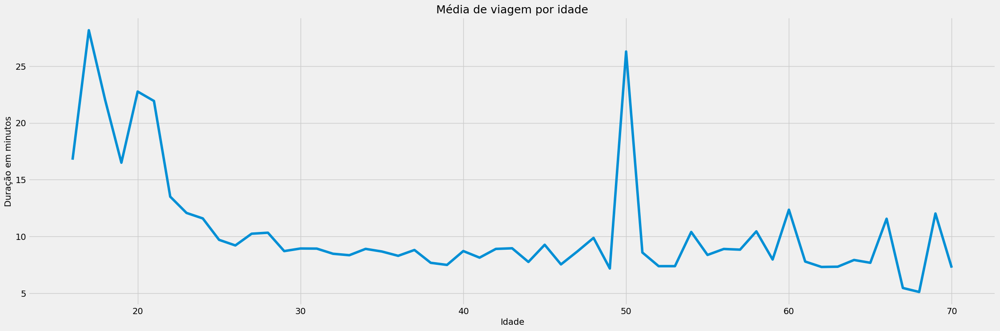

In [32]:
# Media de viagem por idade
plt.figure(figsize = (25,8))

plt.title('Média de viagem por idade', fontsize=18)
plt.xlabel('Idade', fontsize=14)
plt.ylabel('Duração em minutos', fontsize=14)

average_trip = df.groupby('age')['tripduration_in_min'].mean().reset_index().rename(columns={'age': 'idade', 'tripduration_in_min':'media'})
sns.lineplot(data =average_trip, x='idade', y='media')
plt.show()


### Dividindo as idades em grupos

In [33]:
df['ageGroup']= pd.cut(
   df['age'],
   bins=[0, 20, 30, 40, 50, 60, sys.maxsize],
   labels=['<20', '20-29', '30-39', '40-49', '50-59', '60+']
)

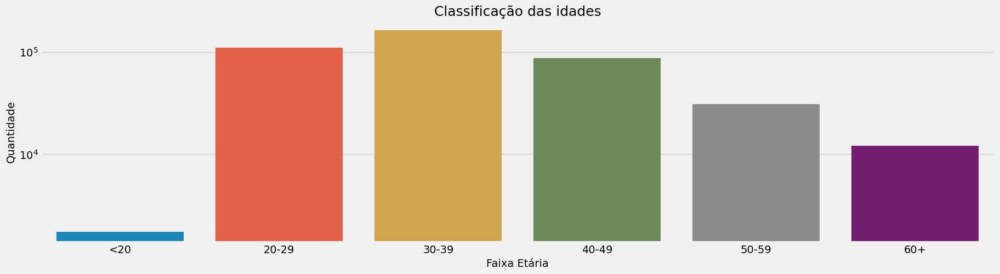

In [34]:
plt.figure(figsize = (20,5))
ax = sns.countplot(x=df["ageGroup"])
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Classificação das idades', fontsize=18)
plt.xlabel('Faixa Etária', fontsize=14)
plt.ylabel('Quantidade', fontsize=14)
plt.show()

### Como é a distribuição da idade por dia de semana?

In [35]:
weekOrder = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday']
fig = px.histogram(df, x="start_weekday_name",
             color='ageGroup', barmode='group',
             height=400, title='Idade x Dia da semana', log_y=True)
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)
fig.update_layout(legend_title_text='Faixa Etária',  yaxis_title='Quantidade', xaxis_title= 'Dias da Samana')
fig.show()

Podemos notar que a concentração para todas as idades está nos finais de semana, cosequentemente podendo gerar um `pico` uma alta procura nesses dias.

## Média de duração da viagem por mês

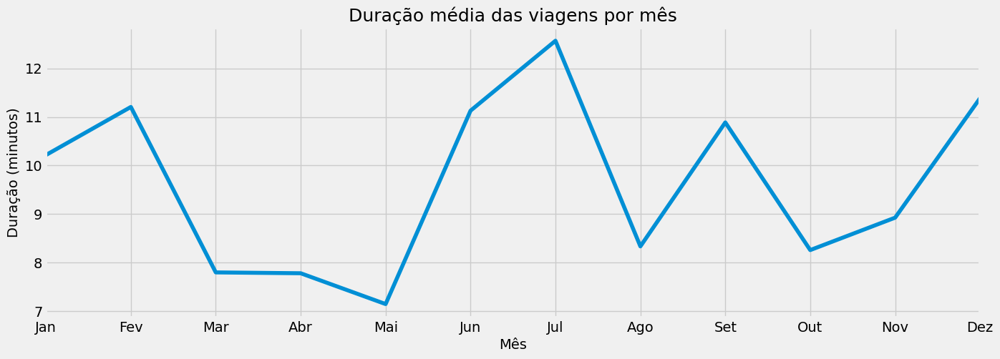

In [36]:
plt.figure(figsize = (15,5))

ax = df.groupby('start_month')['tripduration_in_min'].mean().plot()
ax.set_xlim(0, 11)
plt.xticks(range(0,12), ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])

plt.title('Duração média das viagens por mês', fontsize=18)
plt.xlabel('Mês', fontsize=14)
plt.ylabel('Duração (minutos)', fontsize=14)
plt.show()

O mês de `Julho` possui a maior duração média, uma possível razão para esse fato, é a independência dos Estados Unidos no dia  4 julho.

In [37]:
july = df[df['start_month'] == 'July'].copy()
july['start_day']= july['starttime'].dt.day

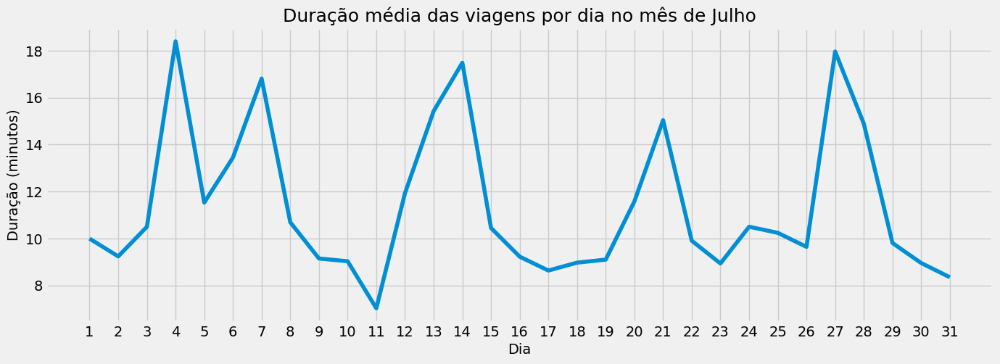

In [38]:
plt.figure(figsize = (15,5))
plt.xticks(range(1,32))

july.groupby('start_day')['tripduration_in_min'].mean().plot()

plt.title('Duração média das viagens por dia no mês de Julho', fontsize=18)
plt.xlabel('Dia', fontsize=14)
plt.ylabel('Duração (minutos)', fontsize=14)
plt.show()

Como deduzido, o dia 4 de julho foi o dia com maior duração média nas viagens. Há outros dias que também se destacam, isso ocorre porque julho é um mês quente e com bastentes festivais.

## Tipos de clientes

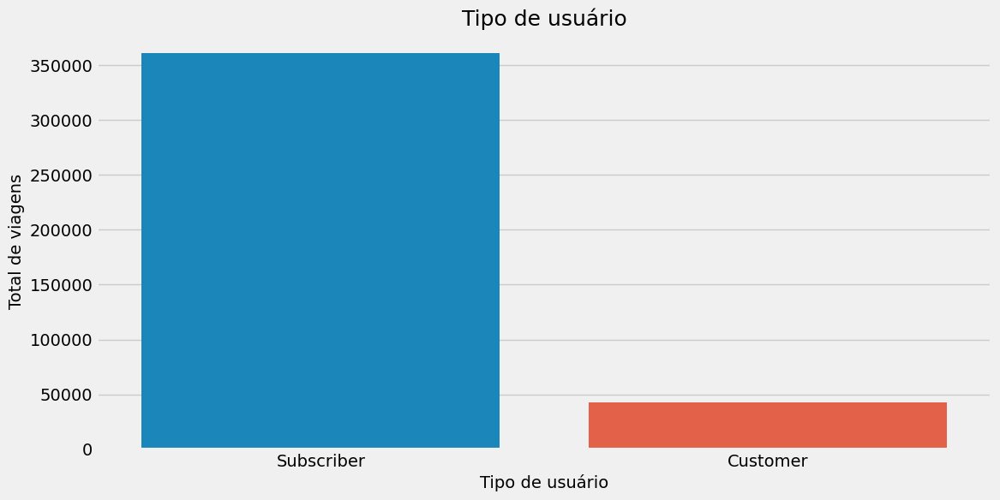

In [39]:
plt.figure(figsize = (12,6))
ax = sns.countplot(data= df, x = 'usertype', order = df['usertype'].value_counts().index)
plt.xlabel('Tipo de usuário', fontsize=14)
plt.ylabel('Total de viagens', fontsize=14)
plt.title('Tipo de usuário', fontsize=18)
plt.show()

O sistema possui 2 tipos de clientes, o ``assinante`` e o ``diário``. Onde o assinante paga um avalor mensal que varia entre $15 até $17 dolares, enquanto o usuário diário paga um valor diário de $4 ou $15 dólares.

## Proporção dos Gênero

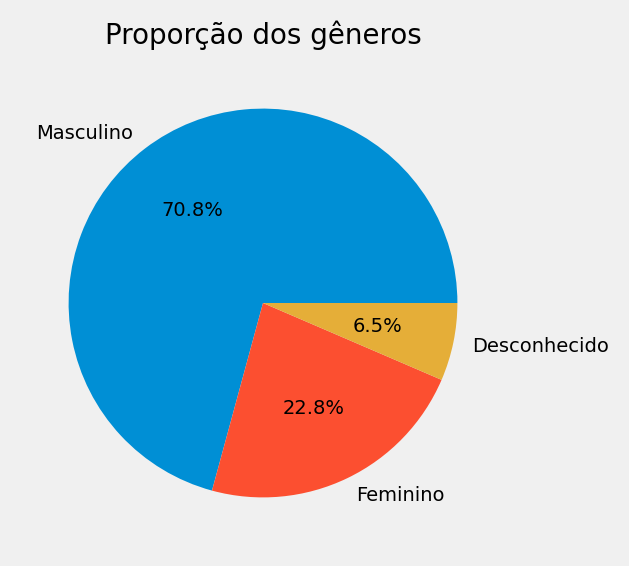

In [40]:
plt.figure(figsize=(3,3), dpi=200)
mylabels = ["Masculino", "Feminino", "Desconhecido"]
plt.pie(df['gender'].value_counts(), labels = mylabels, autopct='%1.1f%%', textprops={'fontsize': 7})
plt.title('Proporção dos gêneros', fontsize=10)
plt.show() 

### Relação Idade e Gênero

In [41]:
# Criando uma nova tabela com idade e gêneros
gender_age = pd.crosstab(index=df['gender'], columns=df['ageGroup'], rownames=['gender'], colnames=['Faixa Etaria'])
gender_age = pd.DataFrame(gender_age) 
gender_age = gender_age.rename(index={1: 'Masculino', 2: 'Feminino', 0: 'Desconhecido'}) #Adicionando nomes as linhas
gender_age = (gender_age / len(df)).round(2)
gender_age.index.name = 'Gênero'

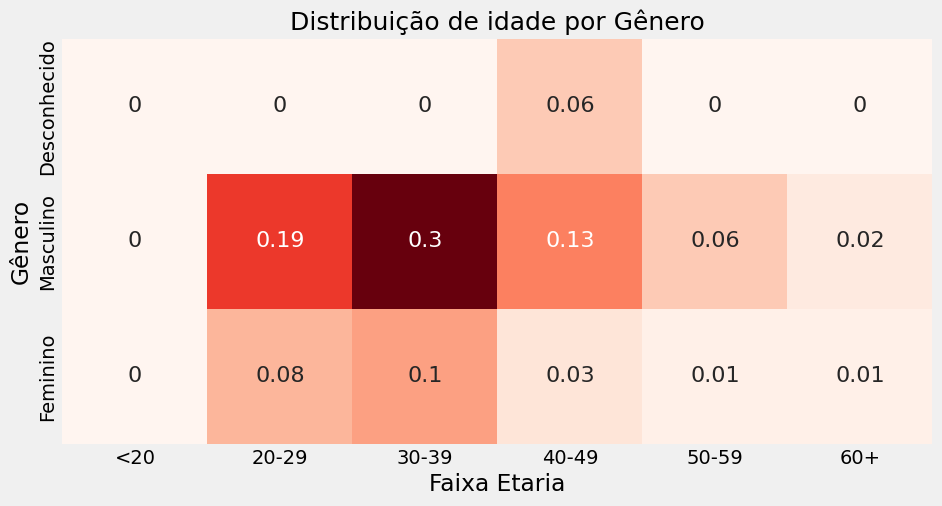

In [42]:
# Cada bloco mostra a porcentagem das viagens que foram feitas por essa idade + gênero
# Somando todas temos 1.0, equivalente a 100%
plt.figure(figsize = (10,5))
ax = sns.heatmap(gender_age, annot=True, linewidths=0, cbar=False, cmap="Reds", annot_kws={"size": 16})
ax.set_title('Distribuição de idade por Gênero', fontsize=18)
plt.show()


O nosso conjuneto de dados possui `30%` de homens com faixa etária de `30 a 39 anos`. Enquanto temos `10%` para mulheres na mesma faixa etária.

#### Viagens durante a semana por gênero

In [43]:
fig = px.histogram(df, x="start_weekday_name",
             color='gender', barmode='group',
             height=400)

generos = {'0': "Desconhcido", '1': "Masculino", '2': "Feminino"}
fig.for_each_trace(lambda t: t.update(name = generos[t.name]))
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)
fig.update_layout(legend_title_text='Gênero',  yaxis_title='Quantidade', xaxis_title= 'Dias da Samana')
fig.show()

É de se esperar que os homems estejam predominantemente todos os dia da semana. Já a distribuição possuem uma alta procura nos dia úteis.

## Qual o horário de maior demanda?

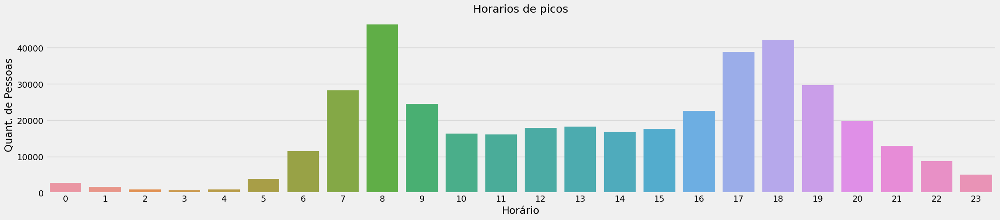

In [44]:
plt.figure(figsize = (25,5))
ax = sns.countplot(x=df["start_hours"])
ax.set(xlabel='Horário', ylabel='Quant. de Pessoas')
plt.title('Horarios de picos', fontsize=18)
plt.show()

Temos dois pontos máximo em nosso gráfico, sendo o global as `8h`, ou seja, é o horário mais procurado para alugar uma bicicleta, e nosso máximo local as `18h`. Podemos partir da `hipótese` que muitos estão indo e vindo do trabalho.

### Tipos diferentes de usuário influencia no horário?

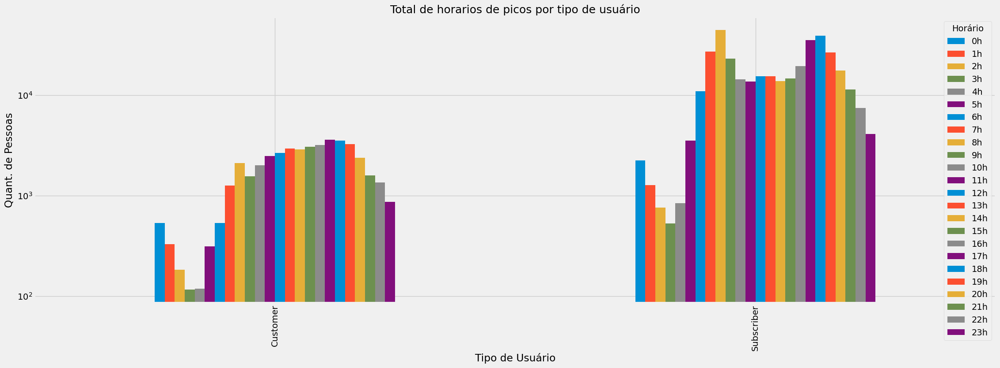

In [45]:
# Horario de picos por tipo de usuário
day=range(0,24)
count_usertype = df.groupby(['usertype','start_hours']).size().unstack()
ax = count_usertype.plot(kind = 'bar',figsize=(25,8))
ax.set(xlabel='Tipo de Usuário', ylabel='Quant. de Pessoas')
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Total de horarios de picos por tipo de usuário', fontsize=18)
plt.legend([str(i)+'h' for i in range(0,24)], title = "Horário")
plt.show()

Temos diferença no pico para cada tipo de usuário, podemos ver que o pico das `8h` e `18h` esta mais relacionado aos clientes assinantes, enquanto os clientes "avulsos" possuem procura crescente período da tarde. Fortalecendo a hipótese de que os assinantes usam mais para as indas e vindas do trabalho.

### Há diferença entre dia de semana e finais de semana?

In [46]:
# Separando dia util de final de semana
weekType = np.where(df['start_weekday'] < 5, 'Weekday', 'Weekend')

In [47]:
# Calculando a quantidades de horas para o dia da semana (Seg-Sex)
weekday = df[weekType == 'Weekday']
weekday = weekday['start_hours'].value_counts().sort_index()

# Calcuando para o final de semana
weekend = df[weekType != 'Weekday']
weekend = weekend['start_hours'].value_counts().sort_index()

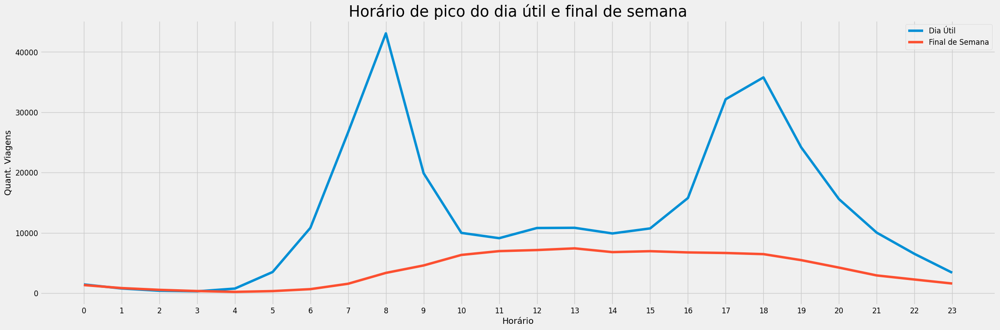

In [48]:
plt.figure(figsize = (25,8))
plt.plot(weekday)
plt.plot(weekend)
plt.legend(['Dia Útil', 'Final de Semana'], fontsize=12)
plt.xticks(range(0,24),weekday.index, fontsize=10)
plt.tick_params(axis='both', which='major', labelsize=12)

#labels
plt.title('Horário de pico do dia útil e final de semana', fontsize=25)
plt.xlabel('Horário', fontsize=14)
plt.ylabel('Quant. Viagens', fontsize=14)
plt.show()

Podemos notar uma semelhança com o gráfico anterior, onde os usuários avulsos, possuem essa onde no periodo da tarde. Enquanto os usuários assinantes possui os mesmos máximos nos horários das 8h e 18h.

## Qual dia da semana de maior procura?

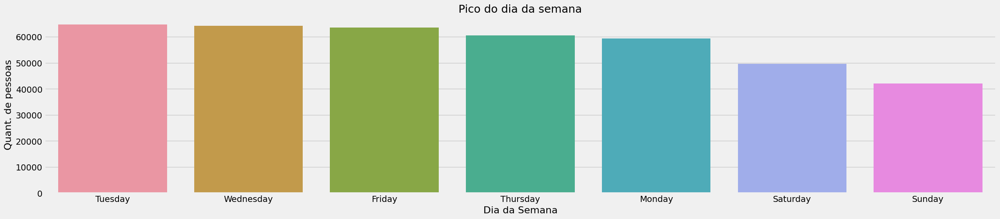

In [49]:
plt.figure(figsize = (25,5))
ax = sns.countplot(data= df, x = 'start_weekday_name', order = df['start_weekday_name'].value_counts().index)
plt.xlabel('Dia da Semana', fontsize=16)
plt.ylabel('Quant. de pessoas', fontsize=16)
plt.title('Pico do dia da semana', fontsize=18)
plt.show()

Os finais de semana são os menos visados pelos usuários.

### O tempo de viagem tem alguma relação com a idade e o dia da semana?

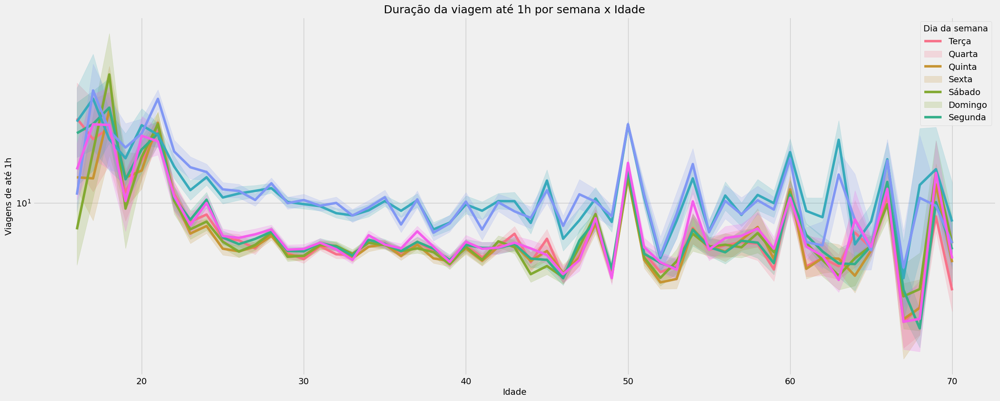

In [50]:
# Verificando duração da viagem por dia da semana em relação a idade
plt.figure(figsize = (25,10))
ax = sns.lineplot(y='tripduration_in_min', x='age', data=df[df['tripduration_in_min'] < 61], hue='start_weekday_name')
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Duração da viagem até 1h por semana x Idade', fontsize=18)
plt.xlabel('Idade', fontsize=14)
plt.ylabel('Viagens de até 1h', fontsize=14)
plt.legend(['Terça', 'Quarta', 'Quinta', 'Sexta', 'Sábado', 'Domingo', 'Segunda'], title = "Dia da semana")
plt.show()

Independente da idade, as clientes costumam fazer viagens mais longas nos finais de semana, vamos confirmar isso no próximo grafico.

### Dia da semana com viagens mais longas

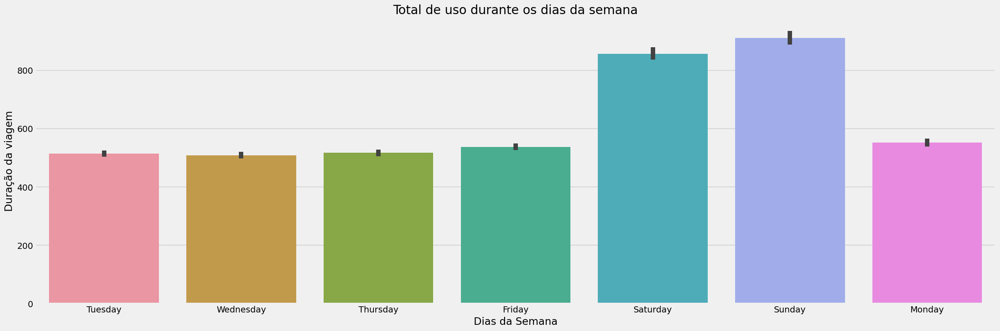

In [51]:
plt.figure(figsize = (25,8))
ax = sns.barplot(data =df ,x='start_weekday_name',
       y='tripduration')
ax.set(xlabel='Dias da Semana', ylabel='Duração da viagem', title='Total de uso durante os dias da semana')
plt.show()

Podemos ver que os finais de semana são os dias que os usuários mais passam tempo usando a bicileta.

## Estações mais procuradas

In [52]:
# Número de estações
print('Total de estações: ',df['start station name'].nunique())

Total de estações:  53


### Estações mais populares

In [53]:
stations = df.groupby(['start station latitude', 'start station longitude', 'start station name']).size().reset_index(name = 'Quant. Pessoas')
stations = stations.sort_values('Quant. Pessoas',ascending = False)

fig = px.scatter_mapbox(stations, lat="start station latitude", lon="start station longitude", hover_name = "start station name", color = "Quant. Pessoas",
                  size = "Quant. Pessoas", color_continuous_scale=px.colors.cyclical.IceFire,width=900, height=600, zoom=12.5, mapbox_style="carto-positron",
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Uma grande concentração da poplaridade é no centro da cidade.

### As 10 estações mais populares

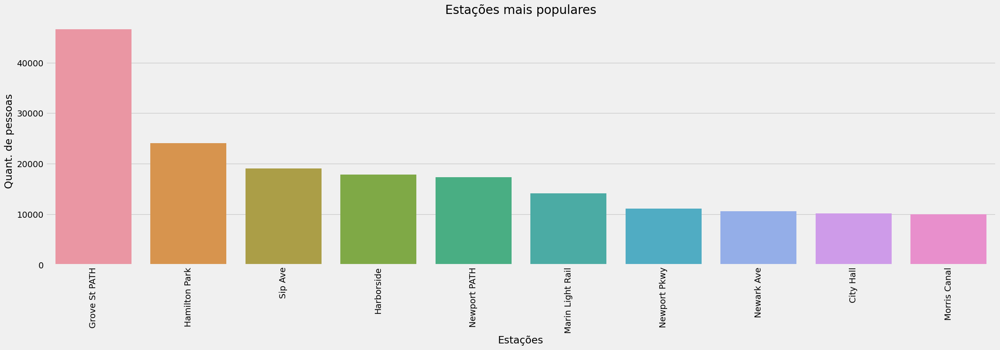

In [54]:
topStartStation = df["start station name"].value_counts().head(10)
plt.figure(figsize = (25,7))
ax = sns.barplot(x=topStartStation.index,
       y=topStartStation)
ax.set(xlabel='Estações', ylabel='Quant. de pessoas', title='Estações mais populares')
plt.xticks(rotation=90)
plt.show()

### Qual a relação das 10 estações mais pupolares com a idade do usuário?

In [55]:
df_age = pd.DataFrame(df[['start station name','ageGroup']].value_counts()).reset_index().rename(columns={'start station name': 'estacao', 'ageGroup': 'faixa etaria', 0:'quant'})
df_age.drop_duplicates(['estacao']).head(10)

,estacao,faixa etaria,quant
0,Grove St PATH,30-39,20168
3,Hamilton Park,30-39,9164
4,Sip Ave,30-39,7201
5,Marin Light Rail,30-39,6775
6,Harborside,30-39,6417
7,Newport PATH,30-39,6292
13,Brunswick & 6th,30-39,4938
14,Monmouth and 6th,30-39,4892
15,Warren St,30-39,4408
16,City Hall,30-39,4334


Incrivelmente a faixa estária dos `30-39` anos está predominando.

### As 10 rotas mais populares

Vamos verificar quais são as rotas Origem-Destino mais realizadas pelos usuários.

In [56]:
trips = df.groupby(['start station name','end station name']).size().reset_index(name = 'Num. of Trips')
trips = trips.sort_values('Num. of Trips',ascending = False)
trips.head(10)

,start station name,end station name,Num. of Trips
991,Hamilton Park,Grove St PATH,8778
939,Grove St PATH,Hamilton Park,6048
224,Brunswick & 6th,Grove St PATH,5251
1764,Marin Light Rail,Grove St PATH,4450
1406,Jersey & 6th St,Grove St PATH,4370
955,Grove St PATH,Marin Light Rail,4167
276,Brunswick St,Grove St PATH,4078
1866,Monmouth and 6th,Grove St PATH,3993
632,Dixon Mills,Grove St PATH,3870
1845,McGinley Square,Sip Ave,3806


As rotas mais populares possuem uma relação de localização, sendo grande parte iniciando e terminando centro da cidade de Jersey.

### Quantidades de vezes que uma estação foi escolhida como Origem e Destino por mês

#### Escolhida como Origem

In [57]:
# Número de vezes que cada estação serviu de origem para uma viagem em cada mês
startStation = df.groupby(['start station name', 'start_month']).size().reset_index().rename(columns={'start station name': 'estacao', 'start_month': 'mes', 0:'quant origem'})
startStation = startStation.sort_values('quant origem',ascending = False)
startStation.head(10)

,estacao,mes,quant origem
204,Grove St PATH,August,5458
214,Grove St PATH,September,5279
208,Grove St PATH,July,4833
213,Grove St PATH,October,4674
209,Grove St PATH,June,4492
211,Grove St PATH,May,4113
203,Grove St PATH,April,3725
212,Grove St PATH,November,3577
226,Hamilton Park,September,3123
210,Grove St PATH,March,3112


#### Escolhida como Destino

In [58]:
# Número de vezes que cada estação foi o destino de uma viagem de cada mês
endStation = df.groupby(['end station name', 'start_month']).size().reset_index().rename(columns={'end station name': 'estacao', 'start_month': 'mes', 0:'quant destino'})
endStation = endStation[endStation['estacao'].isin(df['start station name'].unique())].reset_index(drop = True)
endStation = endStation.sort_values('quant destino',ascending = False)
endStation.head(10)

,estacao,mes,quant destino
213,Grove St PATH,October,6766
204,Grove St PATH,August,6671
214,Grove St PATH,September,6541
208,Grove St PATH,July,6265
211,Grove St PATH,May,5283
209,Grove St PATH,June,5223
212,Grove St PATH,November,5048
203,Grove St PATH,April,4577
210,Grove St PATH,March,3486
205,Grove St PATH,December,3027


#### Resultado final das escolhas

In [59]:
# Resultado final
station_use = pd.merge(startStation, endStation, on=['estacao', 'mes'])
station_use['total'] = station_use['quant origem'] + station_use['quant destino']
station_use = station_use.sort_values('total',ascending = False)
station_use.head(10)

,estacao,mes,quant origem,quant destino,total
0,Grove St PATH,August,5458,6671,12129
1,Grove St PATH,September,5279,6541,11820
3,Grove St PATH,October,4674,6766,11440
2,Grove St PATH,July,4833,6265,11098
4,Grove St PATH,June,4492,5223,9715
5,Grove St PATH,May,4113,5283,9396
7,Grove St PATH,November,3577,5048,8625
6,Grove St PATH,April,3725,4577,8302
9,Grove St PATH,March,3112,3486,6598
8,Hamilton Park,September,3123,2840,5963


A estação Grove St PATH é a mais procurada, sendo quase todos os meses de 2019.

### Número total de vezes que cada estação foi usada por mês

In [60]:
pd.crosstab(index = station_use['estacao'], columns = station_use['mes'], values = station_use['total'], aggfunc = 'sum')

mes,April,August,December,February,January,July,June,March,May,November,October,September
estacao,,,,,,,,,,,,
5 Corners Library,505.0,538.0,162.0,200.0,176.0,524.0,455.0,330.0,429.0,292.0,509.0,588.0
Astor Place,654.0,782.0,521.0,452.0,485.0,696.0,810.0,528.0,702.0,603.0,689.0,723.0
Baldwin at Montgomery,694.0,891.0,341.0,394.0,416.0,873.0,835.0,429.0,740.0,535.0,730.0,807.0
Bergen Ave,541.0,605.0,416.0,328.0,271.0,636.0,627.0,336.0,577.0,557.0,719.0,649.0
Brunswick & 6th,1538.0,1902.0,1099.0,852.0,954.0,1973.0,1561.0,1154.0,1479.0,1586.0,1920.0,1999.0
Brunswick St,1307.0,1916.0,832.0,964.0,861.0,1729.0,1554.0,1123.0,1381.0,1138.0,1694.0,1759.0
Christ Hospital,373.0,382.0,201.0,168.0,240.0,420.0,463.0,266.0,407.0,306.0,428.0,449.0
City Hall,1808.0,2239.0,982.0,1022.0,1069.0,2210.0,2231.0,1440.0,1919.0,1413.0,1973.0,2493.0
Columbus Dr at Exchange Pl,NaN,4799.0,1653.0,NaN,NaN,2275.0,NaN,NaN,NaN,2802.0,4041.0,4841.0


### Relação de viagem que começam e terminam na mesma estação

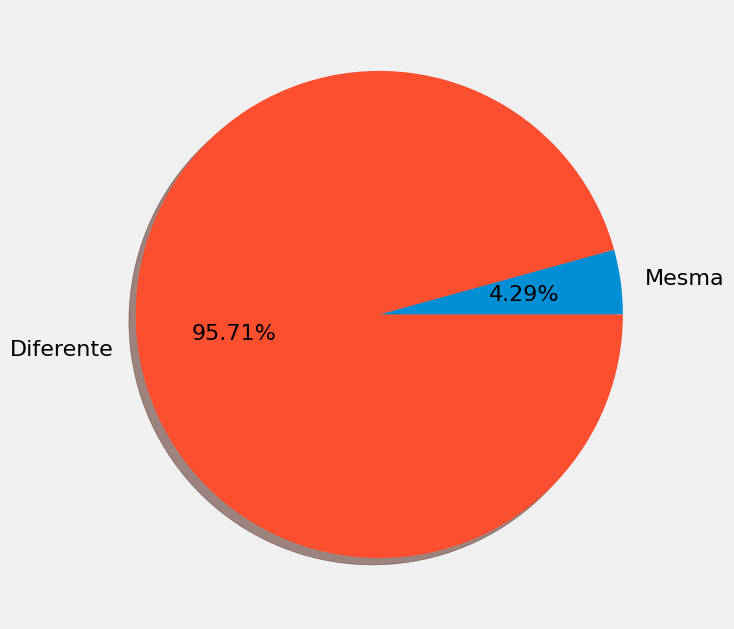

In [61]:
# Quantidade de viagem que começam e terminam na mesma estação
mesma = df[df['start station name'] == df['end station name']].shape[0]

#Quantidade de viagens que começaram e terminanram em estações diferentes
diff = df.shape[0]-mesma

plt.figure(figsize=(7,8))
plt.pie([mesma,diff], labels=['Mesma', 'Diferente'],
        shadow=True,  autopct='%1.2f%%', textprops={'fontsize': 16})
plt.show()

### Distribuição da idade e gênero por estação

#### Ditribuição gênero por estação

In [62]:
stationGender = df.groupby(['start station name', 'gender']).size().reset_index(name='count')
stationGender = stationGender[stationGender['start station name'].isin(topStartStation.index)].reset_index(drop = True)
stationGender['gender'] = stationGender['gender'].map({0:'desconhecido', 1: 'masculino', 2: 'feminino'})

In [63]:
fig = px.bar(stationGender, x='start station name', y='count',
              title='Gênero x Estação', color='gender', log_y=True)
fig.update_layout(legend_title_text='Gênero',  yaxis_title='Quantidade', xaxis_title= 'Estações')
fig.show()

#### Ditribuição idade por estação

In [64]:
stationAge = df.groupby(['start station name', 'gender', 'ageGroup']).size().reset_index(name='count')
stationAge = stationAge[stationAge['start station name'].isin(topStartStation.index)].reset_index(drop = True)

In [65]:
fig = px.histogram(stationAge, x="start station name", y='count',
             color='ageGroup', barmode='group', title='Idade x Estação', log_y=True)
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)
fig.update_layout(legend_title_text='Faixa Etária',  yaxis_title='Quantidade', xaxis_title= 'Estações')
fig.show()

Por se tratar de uma área residencial, a Sip Ave concentrar grande partes dos jovens menores de 20 anos. Para as demais idades, temos uma distribuição próxima.

## Analisando corridas paralelas

Iremos levar em consideração que para ser considerada uma corrida paralela, os usuários possuiram uma difereça de `30 segundos` entre as saídas.

In [66]:
df_paralela = df[['starttime', 'stoptime', 'start station name', 'end station name']].copy()
df_paralela["starttime"] = df_paralela["starttime"].dt.round("min")
df_paralela["stoptime"] = df_paralela["stoptime"].dt.round("min")

In [67]:
df_paralela['User Row'] = df_paralela.index.astype(str)
df_paralela.head()

,starttime,stoptime,start station name,end station name,User Row
0,2019-01-01 03:09:00,2019-01-01 03:13:00,Exchange Place,Essex Light Rail,0
1,2019-01-01 05:18:00,2019-01-01 05:26:00,Exchange Place,Washington St,1
2,2019-01-01 10:37:00,2019-01-01 10:49:00,Exchange Place,Liberty Light Rail,2
3,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,3
4,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,4


In [68]:
df_2 = df_paralela.groupby(['starttime','stoptime','start station name','end station name'], as_index = False).agg({'User Row': ','.join}).reset_index(drop=True)
df_duplas = df_2[df_2['User Row'].str.contains(",")].reset_index(drop=True)
df_duplas

,starttime,stoptime,start station name,end station name,User Row
0,2019-01-01 01:03:00,2019-01-01 01:07:00,Manila & 1st,Hamilton Park,"14389,14390"
1,2019-01-01 09:45:00,2019-01-01 09:48:00,Jersey & 6th St,Newark Ave,"13410,13411"
2,2019-01-01 11:34:00,2019-01-01 11:37:00,Hamilton Park,Manila & 1st,"8143,8144,8145"
3,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,"3,4"
4,2019-01-01 13:48:00,2019-01-01 14:05:00,Grove St PATH,Grand St,"1699,1700"
...,...,...,...,...,...
10507,2019-12-31 18:46:00,2019-12-31 18:48:00,Columbus Dr at Exchange Pl,Harborside,"404864,404865"
10508,2019-12-31 19:07:00,2019-12-31 19:14:00,Liberty Light Rail,Grove St PATH,"404870,404872"
10509,2019-12-31 19:07:00,2019-12-31 19:15:00,City Hall,Brunswick St,"404871,404873"
10510,2019-12-31 19:18:00,2019-12-31 19:23:00,Harborside,Newport PATH,"404879,404880"


In [69]:
# Testando se os ciclistas sairam juntos
df.loc[3:4][['starttime', 'stoptime', 'start station name', 'end station name']]

,starttime,stoptime,start station name,end station name
3,2019-01-01 12:43:38.643,2019-01-01 13:09:54.528,Exchange Place,Washington St
4,2019-01-01 12:43:39.601,2019-01-01 13:09:46.510,Exchange Place,Washington St


In [82]:
# Verificando o maior grupo de pessoas pedalando juntas
print(f"Maior grupo viajando juntos em 2019: {df_duplas['User Row'].str.split(',').agg(len).to_frame(name='Count').max().values[0]}")

Maior grupo viajando juntos em 2019: 6


In [80]:
print(f"Total de grupos em 2019: {df_duplas.shape[0]}")

Total de grupos em 2019: 10512


### As 10 estações de origem mais escolhidas para sair em grupo

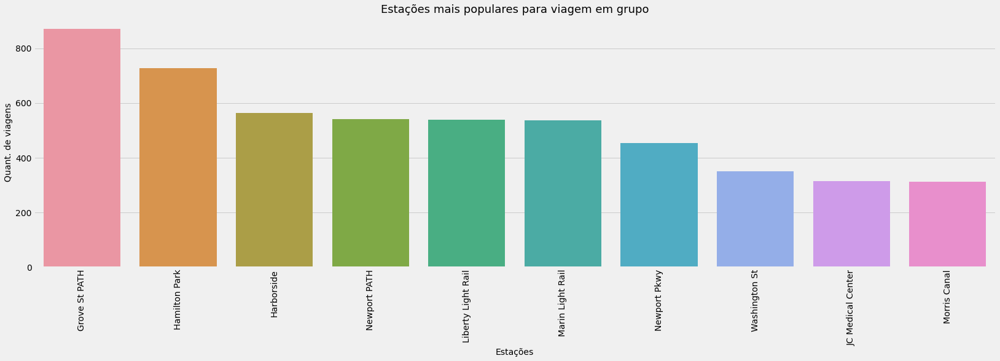

In [370]:
popularStation = df_duplas.groupby(['start station name']).size().sort_values(ascending=False).head(10)
plt.figure(figsize = (25,7))
ax = sns.barplot(x=popularStation.index, y=popularStation)
plt.xticks(rotation=90)
plt.title('Estações mais populares para viagem em grupo', fontsize=18)
plt.xlabel('Estações', fontsize=14)
plt.ylabel('Quant. de viagens', fontsize=14)
plt.show()

### As 10 rotas mais escolhidas para sair em grupo

In [371]:
trips = df_duplas.groupby(['start station name','end station name']).size().reset_index(name = 'Num. of Trips')
trips = trips.sort_values('Num. of Trips',ascending = False)
trips.head(10)

,start station name,end station name,Num. of Trips
499,Hamilton Park,Grove St PATH,273
826,Liberty Light Rail,Liberty Light Rail,208
94,Brunswick & 6th,Grove St PATH,168
124,Brunswick St,Grove St PATH,121
972,Monmouth and 6th,Grove St PATH,116
912,Marin Light Rail,Grove St PATH,115
460,Grove St PATH,Hamilton Park,112
473,Grove St PATH,Marin Light Rail,103
720,Jersey & 6th St,Grove St PATH,99
1103,Newport PATH,Harborside,99


## Conclusão da Análise

- Podemos ver um maior número de ciclistas do sexo masculino. 
- Podemos ver que há mais assinantes anuais do que clientes comuns. 
- Os horários mais procurados são as 8h e 18h, consequentimente horarios de inicio e termino de espediente.
- Há um grande numero de pessoa na faixa etária de 30 a 39 anos.
- Há um baixo numero de clientes mês de Maio.
- Quase 96% dos passeios têm diferentes locais de início e término.
- O maior numero de pessoas andando juntas foram de 6.
- As estações do centro da cidade são as mais procuradas.
- Os não assinantes usam mais durante o final de semana.
- Grande parte do jovens menos de 20 anos, usam no bairro vizinho ao centro da cidade.

# Realizando Predição

## Modelando conjunto de dados

In [372]:
def applyer(row):
    if row.dayofweek == 5 or row.dayofweek == 6:
        return 1
    else:
        return 0

In [373]:
def get_matrics(algorithm, y_pred, y_actual):
    rmse_m = rmse(y_actual, y_pred)
    mae_m = mean_absolute_error(y_actual, y_pred)
    mse_m = mean_squared_error(y_actual, y_pred)
    print(f"RMSR: {rmse_m}")
    print(f"MAE: {mae_m}")
    print(f"MSE: {mse_m}")
    return algorithm, rmse_m, mae_m, mse_m

In [374]:
# Preparando tabela de metricas
table = PrettyTable()
table.field_names = ['Modelo', 'RMSR', 'MAE', 'MSE']

In [375]:
# Preparação e agrupamento dos dados
data = pd.DataFrame()
data['starttime'] = df['starttime'].dt.round('h').copy()
data = data.groupby(['starttime']).size().reset_index(name='count_trip')

In [376]:
# Adicionando novas colunas
data['hour'] = data['starttime'].dt.hour
data['day_of_week'] = data['starttime'].dt.weekday
data['weekend'] = data['starttime'].apply(applyer)

In [377]:
# Feriados americanos
# Recomendo usar o PROPHET, porem no colab e pc fica dando erro de instalação.
holiday = ['2019-01-01', '2019-01-18', '2019-02-12', '2019-02-15',
          '2019-05-08', '2019-05-30', '2019-06-19', '2019-07-04',
          '2019-09-05', '2019-10-10', '2019-11-11', '2019-11-24',
          '2019-12-25', '2019-12-25', '2020-01-01']
data['holiday'] = data['starttime'].apply(lambda x: 1 if (str(x.date()) in holiday) else 0)

In [378]:
# Vamos treinar nosso modelo, diferenciando os dia da semana, finais de samana e feriados.
data

,starttime,count_trip,hour,day_of_week,weekend,holiday
0,2019-01-01 00:00:00,2,0,1,0,1
1,2019-01-01 01:00:00,3,1,1,0,1
2,2019-01-01 02:00:00,5,2,1,0,1
3,2019-01-01 03:00:00,6,3,1,0,1
4,2019-01-01 04:00:00,5,4,1,0,1
...,...,...,...,...,...,...
8430,2019-12-31 20:00:00,25,20,1,0,0
8431,2019-12-31 21:00:00,14,21,1,0,0
8432,2019-12-31 22:00:00,10,22,1,0,0
8433,2019-12-31 23:00:00,10,23,1,0,0


In [379]:
data.set_index('starttime', inplace=True)

## Analisando a Série Temporal

In [380]:
fig = px.line(data,y='count_trip')
fig.show()

In [381]:
decomposicao = seasonal_decompose(data.count_trip, period=24*30, model='additive')
tendencia = decomposicao.trend
sazonal = decomposicao.seasonal
aleatorio = decomposicao.resid

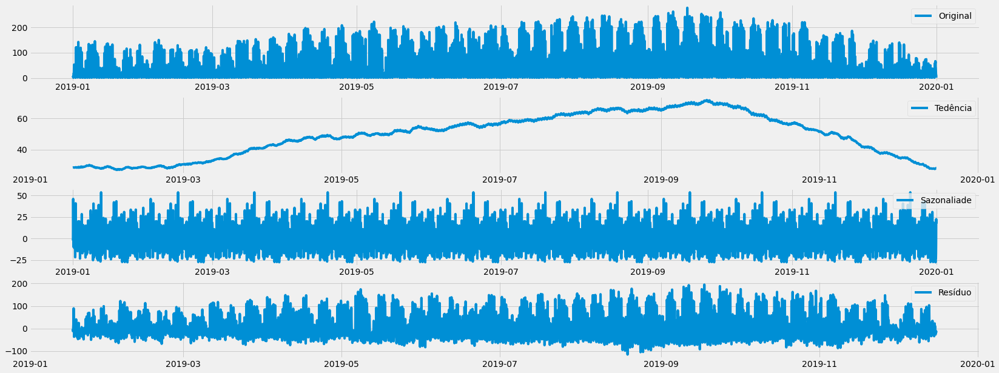

In [382]:
fig, ax = plt.subplots(4, 1, figsize=(25,10))

ax[0].plot(data.count_trip, label= 'Original')
ax[0].legend()

ax[1].plot(tendencia, label= 'Tedência')
ax[1].legend()

ax[2].plot(sazonal, label= 'Sazonaliade')
ax[2].legend()

ax[3].plot(aleatorio, label= 'Resíduo')
ax[3].legend()
plt.show()

## Separação em Treinamento e Teste

In [383]:
# Vamos tentar prever os 2 últimos meses
treino = data.loc['2019-01-01':'2019-11-01']
teste = data.loc['2019-11-01':]

In [384]:
X_treino = treino.drop('count_trip', axis=1)
y_treino = treino.count_trip

X_teste = teste.drop('count_trip', axis=1)
y_teste = teste.count_trip

In [385]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=data.index, y=y_treino, name='Treinamento'))
fig.add_trace(go.Scatter(x=X_teste.index, y=y_teste, name='Teste'))
fig.update_layout(margin={"r":10,"t":10,"l":10,"b":10})
fig.show()

# Previsão com Random Forest Regressor

In [386]:
# Treinando
rfr = RandomForestRegressor(n_estimators=500, random_state=1)
rfr.fit(X_treino, y_treino)
 
# Previsao
preds = rfr.predict(X_teste)

# Métrica
modelo, rmsr, mae, mse = get_matrics('Randon Forest Regressor', preds, y_teste)
table.add_row([modelo, round(rmsr,5), round(mae,5), round(mse,5)])

#Gráfico 
fig = go.Figure()
fig.add_trace(go.Scatter(x=X_treino.index, y=y_treino, name='Treinamento'))
fig.add_trace(go.Scatter(x=X_teste.index, y=y_teste, name='Teste'))
fig.add_trace(go.Scatter(x=X_teste.index, y=preds, name='Previsão'))
fig.update_layout(margin={"r":10,"t":10,"l":10,"b":10})
fig.show()


RMSR: 30.76557791967963
MAE: 19.243665458207104
MSE: 946.5207847318787


## Validação Cruzada

In [387]:
# Testanto com o k-Fold como cada modelo
x = data.drop('count_trip', axis=1)
y = data.count_trip
n_kfold = 5

# Configuração KFold.
# shuffle=True, Shuffle (embaralhar) o dataset.
kfold = StratifiedKFold(n_splits=n_kfold, shuffle=True)

SEED = 42
np.random.seed(SEED)

# Instancias de modelos.
rfr = RandomForestRegressor(n_estimators=500, random_state=1)
cross_val_metric = math.sqrt(-(cross_val_score(rfr, x, y, cv=kfold, scoring='neg_mean_squared_error').mean()))
print(f'RMSR: {cross_val_metric}')

c:\Users\Marcos Eduardo\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\model_selection\_split.py:676: UserWarning:

The least populated class in y has only 1 members, which is less than n_splits=5.



RMSR: 26.871018529499302


In [388]:
table.add_row(['Random Forest R. K-Fold 5', round(cross_val_metric,5), None, None])

# Previsão com XGBoost

In [389]:
reg = xgb.XGBRegressor(n_estimators=1000)
reg.fit(X_treino, y_treino,
        eval_set=[(X_treino, y_treino), (X_teste, y_teste)],
        early_stopping_rounds=50,
       verbose=False)

c:\Users\Marcos Eduardo\AppData\Local\Programs\Python\Python39\lib\site-packages\xgboost\sklearn.py:793: UserWarning:

`early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.



XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=1000,
             n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0,
             reg_alpha=0, reg_lambda=1, ...)

Podemos ver a importancia dos recusos. Está é uma metrica que simplismente resume quantas vezes cada rescurso é dividido.

E podemos notar que as horas é os dividido na árvore.

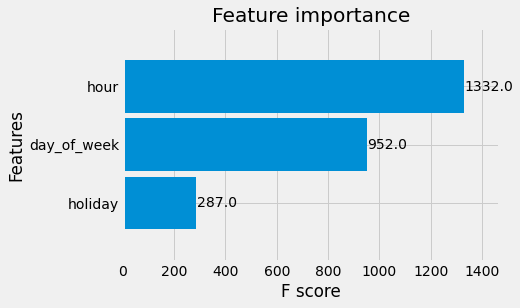

In [390]:
_ = xgb.plot_importance(reg, height=0.9)

In [391]:
teste_xgb = teste.copy()
treino_xgb = treino.copy()

In [392]:
# Previsão
teste_xgb['previsao'] = reg.predict(X_teste)

# Métrica
modelo, rmsr, mae, mse = get_matrics('XGBoost', teste_xgb.previsao, teste_xgb.count_trip)
table.add_row([modelo, round(rmsr,5), round(mae,5), round(mse,5)])

# Gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=treino_xgb.index, y=treino_xgb.count_trip, name='Treinamento'))
fig.add_trace(go.Scatter(x=X_teste.index, y=y_teste, name='Teste'))
fig.add_trace(go.Scatter(x=teste_xgb.index, y=teste_xgb.previsao, name='Previsão'))
fig.update_layout(margin={"r":10,"t":10,"l":10,"b":10})
fig.show()

RMSR: 23.102976559396858
MAE: 14.590669935182781
MSE: 533.7475259040407


# Previsão com Arima

In [393]:
y_treino.index = pd.DatetimeIndex(y_treino.index).to_period('H')

In [394]:
# treinamento
model_fit = ARIMA(y_treino, order=(2, 1, 2)).fit()

# Predição
predictions = model_fit.predict(0, len(y_teste)-1, typ='levels')

# Métrica
modelo, rmsr, mae, mse = get_matrics('Arima', predictions, y_teste)
table.add_row([modelo, round(rmsr,5), round(mae,5), round(mse,5)])

# Grafico
fig = go.Figure()
fig.add_trace(go.Scatter(x=X_treino.index, y=y_treino, name='Treinamento'))
fig.add_trace(go.Scatter(x=X_teste.index, y=y_teste, name='Teste'))
fig.add_trace(go.Scatter(x=X_teste.index, y=predictions, name='Previsão'))
fig.update_layout(margin={"r":10,"t":10,"l":10,"b":10})
fig.show()

RMSR: 46.12083933625689
MAE: 32.38701892390552
MSE: 2127.1318210808213


# Previsão com Sarimax

In [395]:
# Treinamento
result = SARIMAX(y_treino, order = (0, 1, 1), seasonal_order =(2, 1, 1, 12)).fit()

# Predição
predictions = result.predict(0, len(y_teste)-1, typ = 'levels').rename("Predictions")

# Métrica
modelo, rmsr, mae, mse = get_matrics('Sarimax', predictions, teste.count_trip)
table.add_row([modelo, round(rmsr,5), round(mae,5), round(mse,5)])

# Gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=X_treino.index, y=y_treino, name='Treinamento'))
fig.add_trace(go.Scatter(x=X_teste.index, y=y_teste, name='Teste'))
fig.add_trace(go.Scatter(x=X_teste.index, y=predictions, name='Previsão'))
fig.update_layout(margin={"r":10,"t":10,"l":10,"b":10})
fig.show()

RMSR: 52.59109483296263
MAE: 37.87723760980587
MSE: 2765.8232557296687


# Previsão com Facebook's Prophet

In [396]:
# Preparação e agrupamento dos dados
df_prophet = pd.DataFrame()
df_prophet['starttime'] = df['starttime'].dt.round('h').copy()
df_prophet = df_prophet.groupby(['starttime']).size().reset_index(name='count_trip')

### Treinamento e Teste

In [397]:
# Reciclando treinamento e teste ja usados
prophet_train = treino.copy()
prophet_test = teste.copy()

prophet_test.drop(['count_trip', 'hour', 'day_of_week', 'weekend', 'holiday'], axis=1, inplace=True)
prophet_train.drop(['hour', 'day_of_week', 'weekend', 'holiday'], axis=1, inplace= True)

A entrada para Prophet é sempre um dataframe com duas colunas: ds e y. A coluna ds (datastamp) deve ter um formato esperado pelos Pandas, idealmente AAAA-MM-DD para uma data ou AAAA-MM-DD HH:MM:SS. A coluna y deve ser numérica e representa a medida que desejamos prever.

Vamos sempre renomear nossas colunas de dataframe antes de alimentá-las no modelo.

In [398]:
prophet_train.reset_index().rename(columns={'starttime':'ds','count_trip':'y'}).head()

,ds,y
0,2019-01-01 00:00:00,2
1,2019-01-01 01:00:00,3
2,2019-01-01 02:00:00,5
3,2019-01-01 03:00:00,6
4,2019-01-01 04:00:00,5


In [399]:
# Treinamento
model = Prophet()
model.fit(prophet_train.reset_index().rename(columns={'starttime':'ds', 'count_trip':'y'}))

02:26:50 - cmdstanpy - INFO - Chain [1] start processing
02:26:58 - cmdstanpy - INFO - Chain [1] done processing


In [400]:
# Predição
prophet_test_fcst = model.predict(df=prophet_test.reset_index().rename(columns={'starttime':'ds'}))

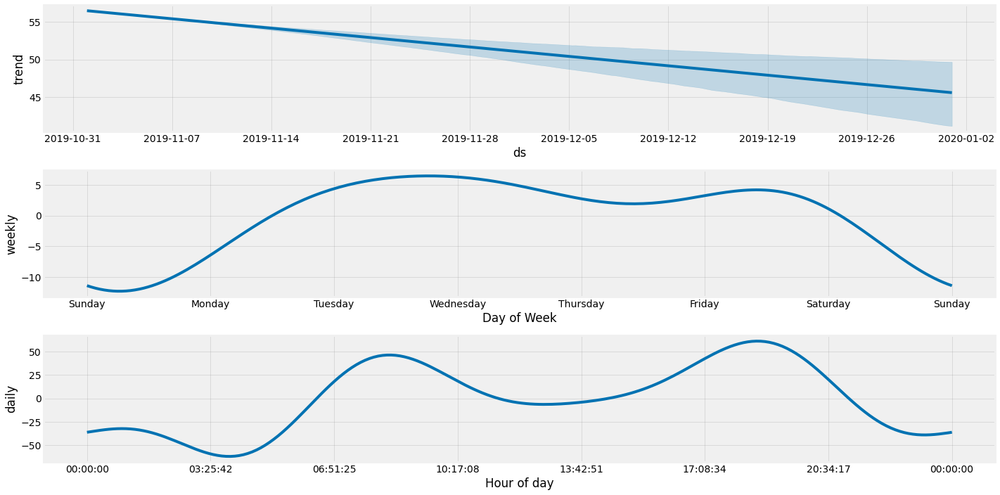

In [401]:
# Componentes previstos pelo prophet
fig = model.plot_components(prophet_test_fcst, figsize=(20,10))

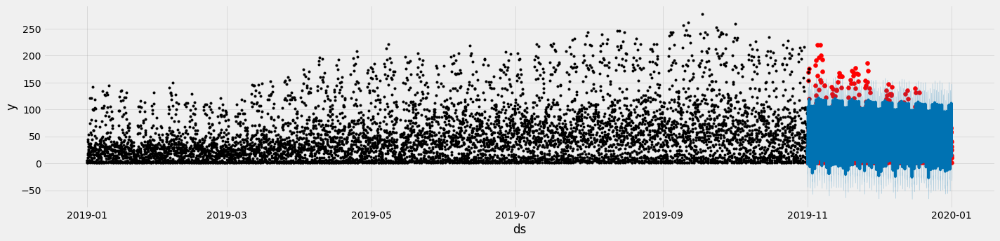

In [402]:
# Gráfico preditivo
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(20)
ax.scatter(teste.index, teste['count_trip'], color='r')
fig = model.plot(prophet_test_fcst, ax=ax)

#### Verificando o mês de novembro

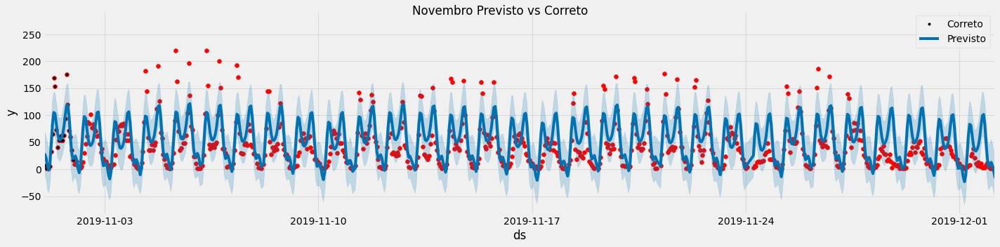

In [403]:
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(20)
ax.scatter(teste.index, teste['count_trip'], color='r')
fig = model.plot(prophet_test_fcst, ax=ax)
ax.set_xbound(lower=teste.index[0],
              upper=teste.index[24*30])
plt.legend(['Correto', 'Previsto'])
plot = plt.suptitle('Novembro Previsto vs Correto')

In [404]:
modelo, rmsr, mae, mse = get_matrics('Prophet', prophet_test_fcst['yhat'], y_teste)
table.add_row([modelo, round(rmsr,5), round(mae,5), round(mse,5)])

RMSR: 34.12518917599046
MAE: 26.044790598079306
MSE: 1164.528536297136


Podemos ver que a Random Forest continua sendo a melhor escolha dentre as apresentadas, mesmo se colocassemos os feriado no Prophet, a melhora seria pouca.

# Resultado das Métricas

In [405]:
table

Modelo,RMSR,MAE,MSE
Randon Forest Regressor,30.76558,19.24367,946.52078
Random Forest R. K-Fold 5,26.87102,None,None
XGBoost,23.10298,14.59067,533.74753
Arima,46.12084,32.38702,2127.13182
Sarimax,52.59109,37.87724,2765.82326
Prophet,34.12519,26.04479,1164.52854


O XGBoost e Randon Forest são "primos" possuem os mesmos ideais em relação a usar árvores de decisão. Porem a diferença mais importante estpa no fato de q o XGBoost sempre dá mais importância ao espaço funcional ao reduzir custos de um modelo enquanto o Radom Forest tenta dar preferência aos hiperparâmetros.